# Optimal Operation of a Building with Electricity-Heat Networks and Seasonal Storage

In [81]:
# Import packages (runs on Julia 1.8.5)
using JuMP, HiGHS
using CSV, DataFrames
using Plots, StatsPlots
using Images
using Dates
using PlotThemes
using DelimitedFiles

We want to schedule the residential system pictured in the diagram below:

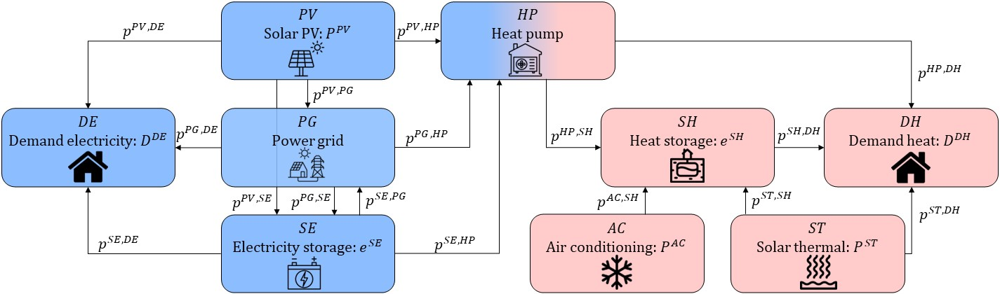

In [82]:
img = load("Diagram.jpg")

## Input data

In [83]:
# Data

# Input number of days, number of time periods per day
nb_d = 365
nb_d_all = 365 + 31 + 28 + 31
Δt = 1 # Duration of each time interval, in hours
year = 2021

# Sets
# For 2021
nb_t_tot = Int(nb_d * 24 / Δt)
T = [1:nb_t_tot;]
D_summer = [4105:4128;] # 21st June 2021
D_winter = [8498:8521;] # 21st Dec 2021
# With the beginning of 2022
nb_t_long = Int(nb_d_all * 24 / Δt)
T_plt_long = [1:nb_t_long;]

# Prices
C_df = CSV.read("Day-ahead Prices_DK2_2021_2022.csv", DataFrame)
C_array = 0.001*(C_df.Price) # Multiply by 0.001 for unit conversion
C_buy = C_array.+0.2
C_sell = C_array

# Electrical load
D_DE = CSV.read("data_D_DE.csv", DataFrame)

# Heat load
D_DH = CSV.read("data_D_DH.csv", DataFrame)
D_DH = (-1) .* D_DH[:,2:end]

# Heat from AC
P_AC = CSV.read("data_P_AC.csv", DataFrame)
P_AC = (-1) .* P_AC[:,2:end]

# Solar prod
nb_solar = 9
eff_solar = 0.9
P_ST = CSV.read("data_P_ST.csv", DataFrame) # Irradiance data
P_ST = coalesce.(P_ST, 0) # Replace missing entries with 0 (no production)
P_ST = (0.001 * eff_solar * nb_solar) .* P_ST[:,2:end] # Multiply by 0.001 for unit conversion

# PV prod
nb_PV = 80
P_PV = CSV.read("data_P_PV.csv", DataFrame) # Production of 1 PV
P_PV = coalesce.(P_PV, 0) # Replace missing entries with 0 (no production)
P_PV = (0.001 * nb_PV) .* P_PV[:,2:end] # Multiply by 0.001 for unit conversion

;

In [84]:
# The upper bound on the charging rate for the heat storage should be at least equal to the maximum possible injection from AC and solar thermal panels
min_ch_rate_SH = maximum(P_AC[:,"prod"].+P_ST[:,"prod"])
print("The upper bound on the charging rate for the thermal storage should be at least ", round(min_ch_rate_SH, digits=3), " kW")

The upper bound on the charging rate for the thermal storage should be at least 10.1 kW

In [85]:
# Other parameters

# Electrical storage data
E_SE_ub = 49 # Capacity upper bound (kWh)
E_SE_lb = 0 # Capacity lower bound (kWh)
P_SE_ch = 16 # Max charge (kW)
P_SE_dis = 10 # Max discharge (kW)
η_SE_ch = 0.97 # Charging efficiency
η_SE_dis = 0.97 # Discharging efficiency
E_SE_init = 0.0 # Initial state of energy (kWh)
E_SE_end = E_SE_init # Final state of energy (kWh)
ρ_SE = 0.99 # Proportion of stored energy that is still available in the next period (i.e. does not leak)

# Heat storage data
E_SH_ub = 4640 # Capacity upper bound (kWh)
E_SH_lb = 0 # Capacity lower bound (kWh)
P_SH_ch = 10.2 # Max charge (kW)
P_SH_dis = 9.18 # Max discharge (kW)
η_SH_ch = 0.78 # Charging efficiency
η_SH_dis = 0.78 # Discharging efficiency
E_SH_init = 3000.0 # Initial state of energy (kWh)
E_SH_end = E_SH_init # Initial state of energy (kWh)
ρ_SH = 1-1*(7e-5) # Proportion of stored energy that is still available in the next period (i.e. does not leak) 

# Heat pump data
P_HP = 15 # Capacity for heat production (kW)
COP = 4 # Coefficient of performance
;

### Plots options

In [86]:
# Set ticks with date
dates_df = DataFrame(CSV.File("data_D_DE.csv"; select=["day","month_nb","hour"]))
dates = [DateTime(year,dates_df[i,"month_nb"],dates_df[i,"day"],dates_df[i,"hour"])  for i in T]
dates_ticks = [DateTime(year,i,1,0)  for i in 1:12]
dates_month = [Dates.format(d, "u") for d in dates_ticks]

dates_long = [DateTime(year,dates_df[i,"month_nb"],dates_df[i,"day"],dates_df[i,"hour"])  for i in T]
append!(dates_long, DateTime(year+1,dates_df[i,"month_nb"],dates_df[i,"day"],dates_df[i,"hour"])  for i in T_plt_long[length(T)+1:end])
dates_ticks_long = [DateTime(year,i,1,0)  for i in 1:12]
append!(dates_ticks_long, DateTime(year+1,i,1,0)  for i in 1:4)
dates_month_long = [Dates.format(d, "u") for d in dates_ticks_long]

# Select theme
theme(:dao)

# Colors 
color_PV_DE = "gold"
color_SE_DE = "palevioletred1"
color_PG_DE = "dodgerblue"
color_PV_ch = "limegreen"
color_PV_PG = "orangered"
color_PV_HP = "darkorange"
color_SE_PG = "darkred"
color_PG_SE = "darkgreen"
color_PG_HP = "plum"
color_SE_HP = "crimson"
color_ST_DH = "lightgoldenrod1"
color_ST_SH = "darkolivegreen2"
color_HP_DH = "lightblue1"
color_HP_SH = "forestgreen"
color_AC_SH = "yellowgreen"
color_SH_DH = "indianred"
color_elec = "cornflowerblue"
color_heat = "lightpink"
;

### Plots data

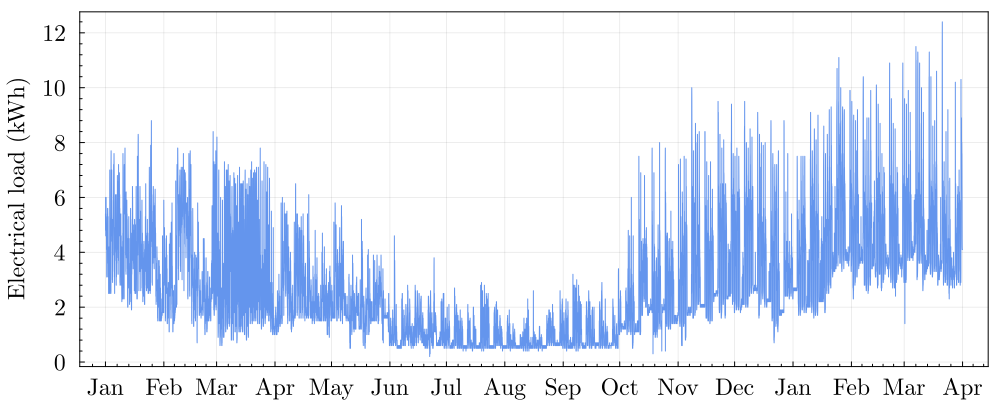

In [87]:
# Plot electrical load
plt_D_DE = plot(dates_long, D_DE[T_plt_long,"load"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400), 
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color=color_elec, 
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_D_DE,"Electrical load (kWh)")

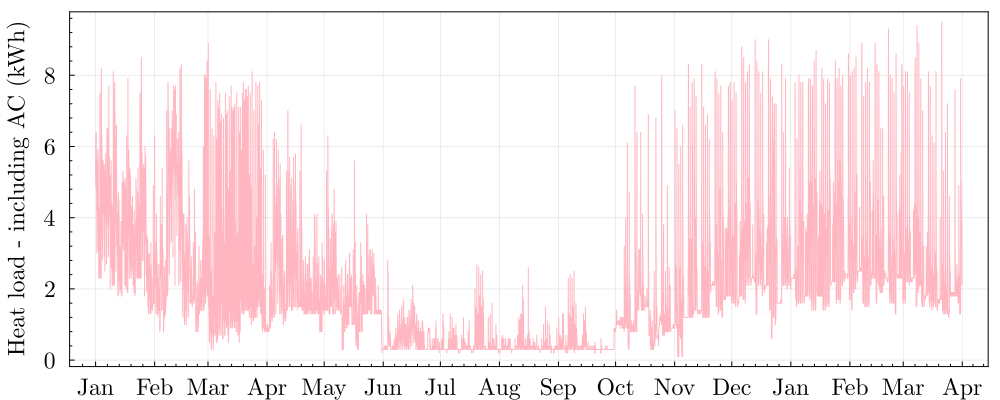

In [88]:
# Plot heat and AC together

D_DH_AC = CSV.read("data_D_DH_P_AC.csv", DataFrame)
D_DH_AC = (-1) .* D_DH_AC[:,2:end]

plt_D_DH_AC = plot(dates_long, D_DH_AC[T_plt_long,"load"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400),
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color=color_heat,
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_D_DH_AC,"Heat load - including AC (kWh)")

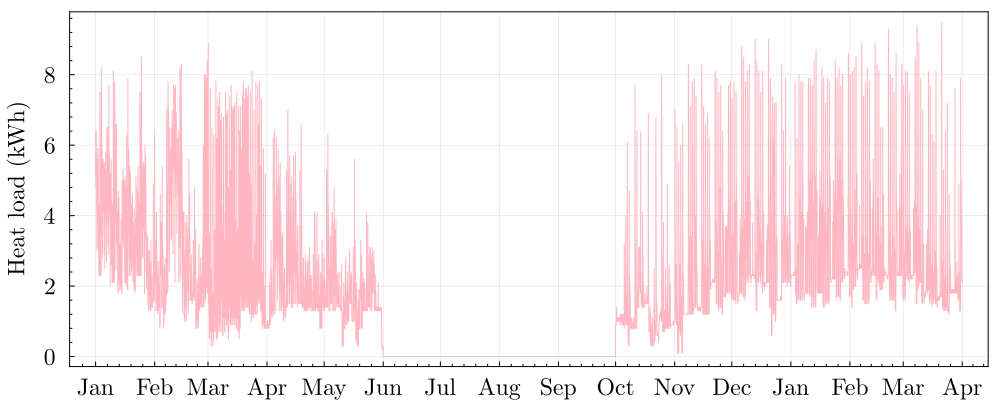

In [89]:
# Plot heat load
plt_D_DH = plot(dates_long, D_DH[T_plt_long,"load"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400), 
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color="lightpink", 
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_D_DH,"Heat load (kWh)")

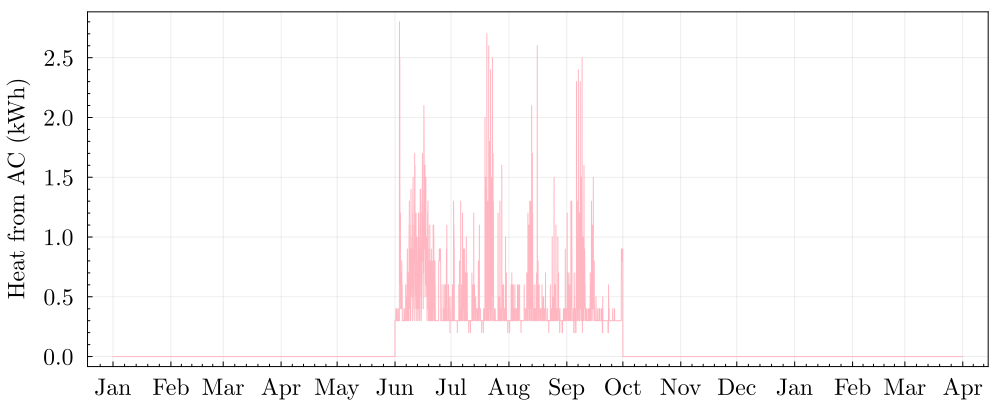

In [90]:
# Plot heat prod from AC
plt_P_AC = plot(dates_long, P_AC[T_plt_long,"prod"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400), 
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color=color_heat, 
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_P_AC,"Heat from AC (kWh)")

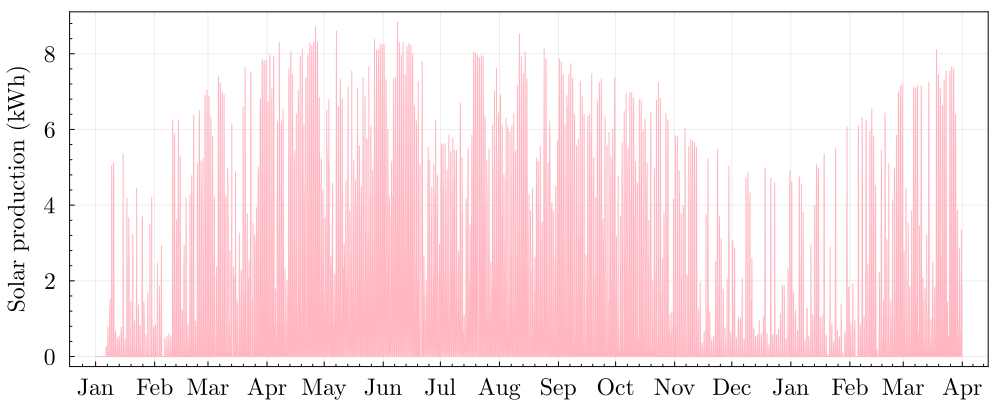

In [91]:
# Plot Solar production
plt_P_ST = plot(dates_long, P_ST[T_plt_long,"prod"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400), 
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color="lightpink", 
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_P_ST,"Solar production (kWh)")

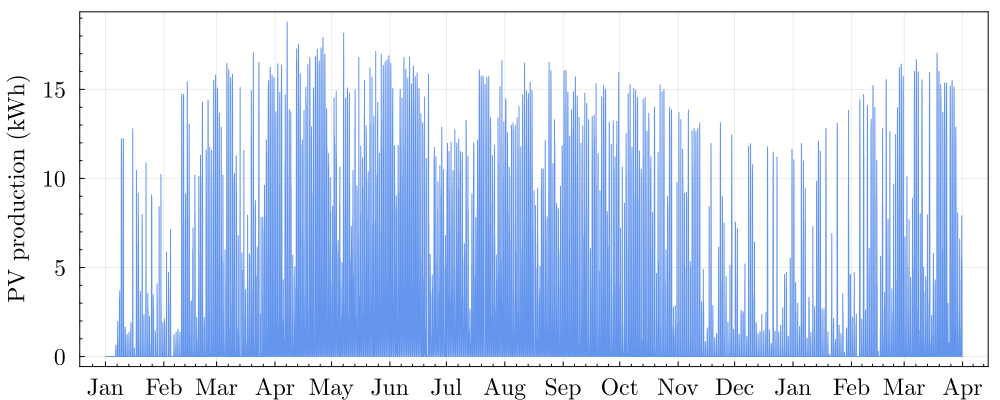

In [92]:
# Plot PV production
plt_P_PV = plot(dates_long, P_PV[T_plt_long,"prod"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400),
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color=color_elec,
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_P_PV,"PV production (kWh)")

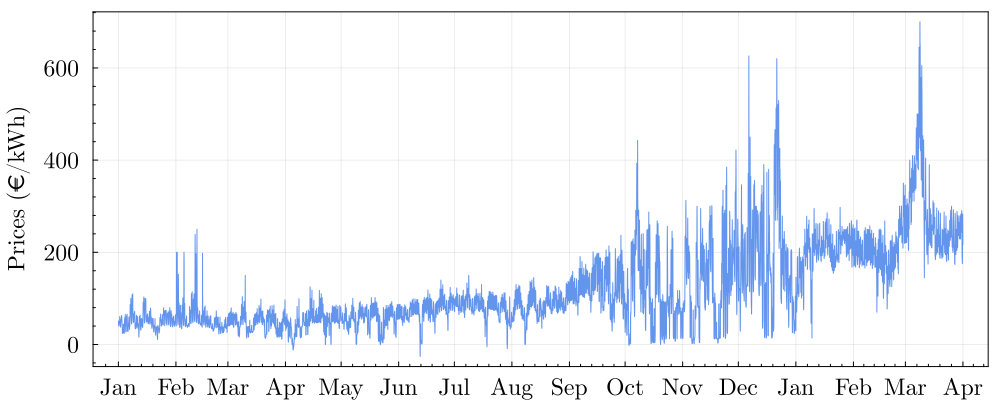

In [93]:
# Plot prices
plt_C = plot(dates_long, C_df[T_plt_long,"Price"], xticks=(dates_ticks_long,dates_month_long), size=(1000,400),
    legend=false, linewidth=1, tickfontsize=15, minorgrid=false, gridalpha=0.1, color=color_elec,
    bottom_margin=2Plots.mm, left_margin=6Plots.mm, guidefontsize=15)
ylabel!(plt_C,"Prices (€/kWh)")

## Function for the optimization of the system

In [94]:
function syst_schedule(T, E_SE_end, E_SH_end, C_buy, C_sell, E_SE_init, E_SH_init, start_d)

    # Sets for negative and for positive prices
    T_neg = []
    T_pos = []
    for t in T
        if C_buy[t] < 0 || C_sell[t] < 0
            append!(T_neg,t)
        else
            append!(T_pos,t)
        end
    end

    # To print the number of binary variables
    #if bin_ch_dch == "no"
    #    nb_bin = 0
    #elseif bin_ch_dch == "all"
    #    nb_bin = 2 * length(T)
    #elseif bin_ch_dch == "neg"
    #    nb_bin = 2 * length(T_neg)
    #end
    #println("Number of binary variables: ", nb_bin)

    model = Model(HiGHS.Optimizer)
    
    # Electricity network variables
    @variable(model, 0 <= p_PV_DE[t in T]) # Power from the PV for electrical consumption (kW)
    @variable(model, 0 <= p_PV_PG[t in T]) # Power from the PV injected on the grid (kW)
    @variable(model, 0 <= p_PV_SE[t in T]) # Power from the PV for charging the electrical storage (kW)
    @variable(model, 0 <= p_PV_HP[t in T]) # Power from the PV for the heat pump (kW)
    @variable(model, 0 <= p_PG_DE[t in T]) # Power from the grid for electrical consumption (kW)
    @variable(model, 0 <= p_PG_SE[t in T]) # Power from the grid for charging the electrical storage (kW)
    @variable(model, 0 <= p_PG_HP[t in T]) # Power from the grid injected to the heat pump (kW)
    @variable(model, 0 <= p_SE_DE[t in T]) # Power from the electrical storage for electrical consumption (kW)
    @variable(model, 0 <= p_SE_PG[t in T]) # Power from the electrical storage injected to the grid (kW)
    @variable(model, 0 <= p_SE_HP[t in T]) # Power from the electrical storage injected to the heat pump (kW)
    @variable(model, E_SE_lb <= e_SE[t in T] <= E_SE_ub) # State of energy of the electrical storage system (kWh)
    # Heat network variables
    @variable(model, 0 <= p_ST_DH[t in T]) # Power from the solar heating for heat consumption (kW)
    @variable(model, 0 <= p_ST_SH[t in T]) # Power from the thermal solar system for charging the heat storage (kW)
    @variable(model, 0 <= p_AC_SH[t in T]) # Power from AC for charging the thermal storage (kW)
    @variable(model, 0 <= p_HP_DH[t in T]) # Power from the heat pump for heat consumption (kW)
    @variable(model, 0 <= p_HP_SH[t in T]) # Power from the heat pump for charging the heat storage (kW)
    @variable(model, 0 <= p_SH_DH[t in T]) # Power from the thermal storage for heat consumption (kW)
    @variable(model, E_SH_lb <= e_SH[t in T] <= E_SH_ub) # State of energy of the heat storage system (kWh)
    # Select if binaries or not
    if bin_ch_dch == "all"
        @variable(model, y_SE[t in T], Bin) # Binary variable to indicate if the electrical storage system is charging or discharging
        @variable(model, y_SH[t in T], Bin) # Binary variable to indicate if the thermal storage system is charging or discharging
    elseif bin_ch_dch == "neg"
        @variable(model, y_SE[t in T_neg], Bin) # Binary variable to indicate if the electrical storage system is charging or discharging
        @variable(model, y_SH[t in T_neg], Bin) # Binary variable to indicate if the thermal storage system is charging or discharging
    end
    
    # Objective function: minimize costs
    @objective(model, Min, sum(Δt*(C_buy[t]*(p_PG_DE[t] + p_PG_SE[t] + p_PG_HP[t]) - C_sell[t]*(p_PV_PG[t] + p_SE_PG[t])) for t in T))
    
    # Constraints electricity load
    @constraint(model, [t in T], D_DE[start_d+t-1,"load"] == p_PV_DE[t] + p_SE_DE[t] + p_PG_DE[t])
    #Constraints heat load
    @constraint(model, [t in T], D_DH[start_d+t-1,"load"] == p_ST_DH[t] + p_SH_DH[t] + p_HP_DH[t])
    # Constraints solar PV
    @constraint(model, [t in T], P_PV[start_d+t-1,"prod"] == p_PV_DE[t] + p_PV_SE[t] + p_PV_HP[t] + p_PV_PG[t])
    # Constraints solar thermal
    @constraint(model, [t in T], p_ST_DH[t] + p_ST_SH[t] <= P_ST[start_d+t-1,"prod"])
    # Constraints air conditionning
    @constraint(model, [t in T], p_AC_SH[t] <= P_AC[start_d+t-1,"prod"])
    # Constraints electricity storage
    @constraint(model, [t in T], e_SE[t] == ρ_SE * (t>1 ? e_SE[t-1] : E_SE_init) + Δt * (η_SE_ch * (p_PV_SE[t] + p_PG_SE[t]) - (1/η_SE_dis) * (p_SE_DE[t] + p_SE_PG[t] + p_SE_HP[t])))
    if E_SE_end != "free"
        @constraint(model, e_SE[T[end]] == E_SE_end)
    end
    if bin_ch_dch == "all"
        @constraint(model, [t in T], (p_PV_SE[t] + p_PG_SE[t]) <= y_SE[t] * P_SE_ch)
        @constraint(model, [t in T], (p_SE_DE[t] + p_SE_PG[t] + p_SE_HP[t]) <= (1-y_SE[t]) * P_SE_dis)
    elseif bin_ch_dch == "neg"
        @constraint(model, [t in T_neg], (p_PV_SE[t] + p_PG_SE[t]) <= y_SE[t] * P_SE_ch)
        @constraint(model, [t in T_neg], (p_SE_DE[t] + p_SE_PG[t] + p_SE_HP[t]) <= (1-y_SE[t]) * P_SE_dis)
        @constraint(model, [t in T_pos], (p_PV_SE[t] + p_PG_SE[t]) <= P_SE_ch)
        @constraint(model, [t in T_pos], (p_SE_DE[t] + p_SE_PG[t] + p_SE_HP[t]) <= P_SE_dis)
    elseif bin_ch_dch == "no"
        @constraint(model, [t in T], (p_PV_SE[t] + p_PG_SE[t]) <= P_SE_ch)
        @constraint(model, [t in T], (p_SE_DE[t] + p_SE_PG[t] + p_SE_HP[t]) <= P_SE_dis)
    end
    # Constraints heat storage
    @constraint(model, [t in T], e_SH[t] == ρ_SH * (t>1 ? e_SH[t-1] : E_SH_init) + Δt * (η_SH_ch * (p_AC_SH[t] + p_HP_SH[t] + p_ST_SH[t]) - (1/η_SH_dis) * p_SH_DH[t]))
    if E_SH_end != "free"
        @constraint(model, e_SH[T[end]] == E_SH_end)
    end
    if bin_ch_dch == "all"
        @constraint(model, [t in T], (p_AC_SH[t] + p_HP_SH[t] + p_ST_SH[t]) <= y_SH[t] * P_SH_ch)
        @constraint(model, [t in T], p_SH_DH[t] <= (1-y_SH[t]) * P_SH_dis)
    elseif bin_ch_dch == "neg"
        @constraint(model, [t in T_neg], (p_AC_SH[t] + p_HP_SH[t] + p_ST_SH[t]) <= y_SH[t] * P_SH_ch)
        @constraint(model, [t in T_neg], p_SH_DH[t] <= (1-y_SH[t]) * P_SH_dis)
        @constraint(model, [t in T_pos], (p_AC_SH[t] + p_HP_SH[t] + p_ST_SH[t]) <= P_SH_ch)
        @constraint(model, [t in T_pos], p_SH_DH[t] <= P_SH_dis)
    elseif bin_ch_dch == "no"
        @constraint(model, [t in T], (p_AC_SH[t] + p_HP_SH[t] + p_ST_SH[t]) <= P_SH_ch)
        @constraint(model, [t in T], p_SH_DH[t] <= P_SH_dis)
    end
    #Constraints heat pump
    @constraint(model, [t in T], p_HP_DH[t] + p_HP_SH[t] == COP * (p_SE_HP[t] + p_PG_HP[t] + p_PV_HP[t]))
    @constraint(model, [t in T], p_HP_DH[t] + p_HP_SH[t] <= P_HP)
        
    #print(model)
    set_silent(model)
    optimize!(model)
    #println(raw_status(model))

    results = Dict()
    
    results["e_SE"] = JuMP.value.(e_SE)
    results["e_SH"] = JuMP.value.(e_SH)
    results["p_SE_DE"] = JuMP.value.(p_SE_DE)
    results["p_SH_DH"] = JuMP.value.(p_SH_DH)
    results["p_SE_PG"] = JuMP.value.(p_SE_PG)
    results["p_SE_HP"] = JuMP.value.(p_SE_HP)
    results["p_PG_SE"] = JuMP.value.(p_PG_SE)
    results["p_PG_DE"] = JuMP.value.(p_PG_DE)
    results["p_PG_HP"] = JuMP.value.(p_PG_HP)
    results["p_AC_SH"] = JuMP.value.(p_AC_SH)
    results["p_HP_SH"] = JuMP.value.(p_HP_SH)
    results["p_HP_DH"] = JuMP.value.(p_HP_DH)
    results["p_PV_SE"] = JuMP.value.(p_PV_SE)
    results["p_PV_DE"] = JuMP.value.(p_PV_DE)
    results["p_PV_PG"] = JuMP.value.(p_PV_PG)
    results["p_PV_HP"] =  JuMP.value.(p_PV_HP)
    results["p_ST_SH"] = JuMP.value.(p_ST_SH)
    results["p_ST_DH"] = JuMP.value.(p_ST_DH)
    results["costs"] = sum(Δt*(C_buy[t]*(JuMP.value(p_PG_DE[t]) + JuMP.value(p_PG_SE[t]) + JuMP.value(p_PG_HP[t])) - C_sell[t]*(JuMP.value(p_PV_PG[t]) + JuMP.value(p_SE_PG[t]))) for t in T)

    return results
end 
;

## Full-horizon Benchmark over 2021

In [95]:
# Run the optimization
bin_ch_dch = "neg"
start_d = 1
results = syst_schedule(T, E_SE_end, E_SH_end, C_buy, C_sell, E_SE_init, E_SH_init, start_d)
;

In [96]:
# Some results
println("Total costs: ", round(results["costs"],digits=2))
println("Grid use total: ",round(sum(results["p_PG_DE"]) + sum(results["p_PG_SE"]) + sum(results["p_PG_HP"]),digits=3)," kWh")
println("Grid injection total: ",round(sum(results["p_PV_PG"]) + sum(results["p_SE_PG"]), digits=3)," kWh")
println("Electrical storage use total: ",round(sum(results["p_PV_SE"]) + sum(results["p_PG_SE"]) + sum(results["p_SE_DE"]) + sum(results["p_SE_PG"]) + sum(results["p_SE_HP"]) ,digits=3)," kWh")
println("Electrical storage capacity used: ",round(maximum(results["e_SE"]),digits=3)," kWh")
println("Heat storage use total: ",round(sum(results["p_AC_SH"]) + sum(results["p_HP_SH"]) + sum(results["p_ST_SH"])+sum(results["p_SH_DH"]),digits=3)," kWh")
println("Decomposition of D_DE:")
println("    - From PV: ",round(sum(results["p_PV_DE"]),digits=3)," kWh")
println("    - From Storage: ",round(sum(results["p_SE_DE"]),digits=3)," kWh")
println("    - From Grid: ",round(sum(results["p_PG_DE"]),digits=3)," kWh")
println("Decomposition of D_DH:")
println("    - From Solar: ",round(sum(results["p_ST_DH"]),digits=3)," kWh")
println("    - From Storage: ",round(sum(results["p_SH_DH"]),digits=3)," kWh")
println("    - From Heat Pump: ",round(sum(results["p_HP_DH"]),digits=3)," kWh")
println("Solar thermal lost: ",round(sum(P_ST[T,"prod"])-sum(results["p_ST_DH"])-sum(results["p_ST_SH"]),digits=3)," kWh" )
println("Solar thermal loss percentage: ",round((sum(P_ST[T,"prod"])-sum(results["p_ST_DH"])-sum(results["p_ST_SH"]))*100/sum(P_ST[T,"prod"]),digits=2),"%" )
println("Electrical storage final level: ",round(results["e_SE"][24*nb_d],digits=3)," kWh" )
println("Heat storage final level: ",round(results["e_SH"][24*nb_d],digits=3)," kWh" )

Total costs: 1611.72
Grid use total: 9701.509 kWh
Grid injection total: 9772.109 kWh
Electrical storage use total: 25677.167 kWh
Electrical storage capacity used: 49.0 kWh
Heat storage use total: 17620.086 kWh
Decomposition of D_DE:
    - From PV: 6901.979 kWh
    - From Storage: 7095.446 kWh
    - From Grid: 6143.075 kWh
Decomposition of D_DH:
    - From Solar: 2843.623 kWh
    - From Storage: 6031.952 kWh
    - From Heat Pump: 5412.925 kWh
Solar thermal lost: -0.0 kWh
Solar thermal loss percentage: -0.0%
Electrical storage final level: 0.0 kWh
Heat storage final level: 3000.0 kWh


In [97]:
# Check simultaneous charge and discharge
for t in T
    if (results["p_PV_SE"][t] + results["p_PG_SE"][t]) >= 1e-6 && (results["p_SE_DE"][t] + results["p_SE_PG"][t] + results["p_SE_HP"][t]) >= 1e-6
        println("Simultaneous charge and discharge for elec storage at t=", t, ",for the price ",C_sell[t])
    elseif (results["p_AC_SH"][t] + results["p_HP_SH"][t] + results["p_ST_SH"][t]) >= 1e-6 && results["p_SH_DH"][t] >= 1e-6
        println("Simultaneous charge and discharge for heat storage at t=", t, ",for the price ",C_sell[t])
    end
end

### Summer day

In [98]:
# Lines for plots
line_PV_DE = Array(results["p_PV_DE"][D_summer])
line_SE_DE = Array(results["p_SE_DE"][D_summer])
line_PG_DE = Array(results["p_PG_DE"][D_summer])
line_PV_SE = Array(results["p_PV_SE"][D_summer])
line_PV_PG = Array(results["p_PV_PG"][D_summer])
line_PV_HP = Array(results["p_PV_HP"][D_summer])
line_SE_PG = Array(results["p_SE_PG"][D_summer])
line_PG_SH = Array(results["p_PG_SE"][D_summer])
line_PG_HP = Array(results["p_PG_HP"][D_summer])
line_SE_HP = Array(-results["p_SE_HP"][D_summer])
line_e_SE = Array(results["e_SE"][D_summer])
line_ST_DH = Array(results["p_ST_DH"][D_summer])
line_ST_SH = Array(results["p_ST_SH"][D_summer])
line_HP_DH = Array(results["p_HP_DH"][D_summer])
line_HP_SH = Array(results["p_HP_SH"][D_summer])
line_AC_SH = Array(results["p_AC_SH"][D_summer])
line_SH_DH = Array(-results["p_SH_DH"][D_summer])
line_e_SH = Array(results["e_SH"][D_summer])
line_D_DE = D_DE[D_summer,:load]
line_P_PV = P_PV[D_summer,:prod]
line_P_ST = P_ST[D_summer,:prod]
;

In [99]:
# Plot electrical demand for a summer day
plt = plot(linewidth=2, legend=:outerright, xticks=1:24, minorticks=false, size=(1000,400), title="Electrical demand for June 21st 2021")
line_ref = zeros(24)
plot!(plt,[1:24], line_ref, label="PV production (kWh)", fillrange=line_ref+line_PV_DE, fillalpha=0.6, linewidth=0, color=color_PV_DE)
line_ref += line_PV_DE
plot!(plt,[1:24], line_ref, label="Storage (kWh)", fillrange=line_ref+line_SE_DE, fillalpha=0.6, linewidth=0, color=color_SE_DE)
line_ref += line_SE_DE
plot!(plt,[1:24], line_ref, label="Grid (kWh)", fillrange=line_ref+line_PG_DE, fillalpha=0.6, linewidth=0, color=color_PG_DE)
plot!(plt,[1:24], line_D_DE, label="Load (kWh)", linewidth=3, color=:black)
;

In [100]:
# Plot PV for a summer day
plt = plot(linewidth=2, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), title="PV production for June 21st 2021")
line_ref = zeros(24)
plot!(plt,[1:24], line_ref, label="Load (kWh)", fillrange=line_ref+line_PV_DE, fillalpha=0.6, linewidth=0, color=color_PV_DE)
line_ref += line_PV_DE
plot!(plt,[1:24], line_ref, label="Storage charge (kWh)", fillrange=line_ref+line_PV_SE, fillalpha=0.6, linewidth=0, color=color_PV_ch)
line_ref += line_PV_SE
plot!(plt,[1:24], line_ref, label="Grid (kWh)", fillrange=line_ref+line_PV_PG, fillalpha=0.6, linewidth=0, color=color_PV_PG)
line_ref += line_PV_PG
plot!(plt,[1:24], line_ref, label="Heat Pump (kWh)", fillrange=line_ref+line_PV_HP, fillalpha=0.6, linewidth=0, color=color_PV_HP)
plot!(plt,[1:24], line_P_PV, label="PV production (kWh)", linewidth=3, color=:black)
;

In [101]:
# Plot grid for a summer day
groupedbar([-line_PV_PG -line_SE_PG line_PG_SH line_PG_DE line_PG_HP], bar_position=:stack, bar_width=0.7, xticks=1:24, minorticks=false, 
        legend=:outerright, size=(1000,400), lw=0, title="Grid use for June 21st 2021", label=["From PV (kWh)" "From storage (kWh)" "To storage (kWh)" "To load (kWh)" "To heat pump (kWh)"],
        color = [color_PV_PG color_SE_PG color_PG_SE color_PG_DE color_PG_HP])
;

In [102]:
# Plot electrical storage for a summer day
plt = groupedbar([line_PV_SE line_PG_SH -line_SE_PG -line_SE_DE -line_SE_HP], bar_position=:stack, bar_width=0.7, xticks=1:24, minorticks=false,
        legend=:outerright, size=(1000,400), lw=0, title="Electrical storage use for June 21st 2021", label=["From PV (kWh)" "From grid (kWh)" "To grid (kWh)" "To load (kWh)" "To heat pump (kWh)"],
        color = [color_PV_ch color_PG_SE color_SE_PG color_SE_DE color_SE_HP])
#subplot = twinx()
plot!(plt,[1:24], line_e_SE, label="State of energy (kW)", linewidth=3, color=:black)
;

In [103]:
# Plot solar thermal for a summer day
plt = plot(linewidth=2, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), title="Solar thermal production for June 21st 2021")
line_ref = zeros(length(D_summer))
plot!(plt,[1:24], line_ref, label="Load (kWh)", fillrange=line_ref+line_ST_DH, fillalpha=0.6, linewidth=0, color=color_ST_DH)
line_ref += line_ST_DH
plot!(plt,[1:24], line_ref, label="Storage charge (kWh)", fillrange=line_ref+line_ST_SH, fillalpha=0.6, linewidth=0, color=color_ST_SH)
plot!(plt,[1:24], line_P_ST, label="Solar thermal production (kWh)", linewidth=3, color=:black)
;

In [104]:
# Plot heat pump for a summer day
groupedbar([-line_PV_HP -line_PG_HP -line_SE_HP line_HP_DH line_HP_SH], bar_position = :stack, bar_width=0.7, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), lw=0,
        title="Heat pump use for June 21st 2021", label=["From PV (kWh)" "From grid (kWh)" "From elec storage (kWh)" "To heat storage (kWh)" "To heat load (kWh)"],
        color = [color_PV_HP color_PG_HP color_SE_HP color_HP_DH color_HP_SH])
;

In [105]:
# Plot heat storage for a summer day
plt = groupedbar([line_HP_SH line_AC_SH line_ST_SH -line_SH_DH], bar_position = :stack, bar_width=0.7, xticks=1:24, minorticks=false, legend=:outerright,
        size=(1000,400), lw=0, title="Thermal storage use for June 21st 2021", label=["From heat pump (kWh)" "From air conditionning (kWh)" "From solar thermal (kWh)" "To load (kWh)"],
        color = [color_HP_SH color_AC_SH color_ST_SH color_SH_DH])
#subplot = twinx()
plot!(plt,[1:24],line_e_SH, label="State of energy (kW)", linewidth=3, color=:black)
;

### Winter day

In [106]:
# Lines
line_PV_DE = Array(results["p_PV_DE"][D_winter])
line_SE_DE = Array(results["p_SE_DE"][D_winter])
line_PG_DE = Array(results["p_PG_DE"][D_winter])
line_PV_SE = Array(results["p_PV_SE"][D_winter])
line_PV_PG = Array(results["p_PV_PG"][D_winter])
line_PV_HP = Array(results["p_PV_HP"][D_winter])
line_SE_PG = Array(results["p_SE_PG"][D_winter])
line_PG_SH = Array(results["p_PG_SE"][D_winter])
line_PG_HP = Array(results["p_PG_HP"][D_winter])
line_SE_HP = Array(results["p_SE_HP"][D_winter])
line_e_SE = Array(results["e_SE"][D_winter])
line_ST_DH = Array(results["p_ST_DH"][D_winter])
line_ST_SH = Array(results["p_ST_SH"][D_winter])
line_HP_DH = Array(results["p_HP_DH"][D_winter])
line_HP_SH = Array(results["p_HP_SH"][D_winter])
line_AC_SH = Array(results["p_AC_SH"][D_winter])
line_SH_DH = Array(results["p_SH_DH"][D_winter])
line_e_SH = Array(results["e_SH"][D_winter])
line_D_DE = D_DE[D_winter,:load]
line_P_PV = P_PV[D_winter,:prod]
line_P_ST = P_ST[D_winter,:prod]
line_D_DH = D_DH[D_winter,:load]
;

In [107]:
# Plot electrical demand for a winter day
plt = plot(linewidth=2, legend=:outerright, xticks=1:24, minorticks=false, size=(1000,400), title="Electrical demand for Dec 21st 2021")
line_ref = zeros(24)
plot!(plt,[1:24], line_ref, label="PV production (kWh)", fillrange=line_ref+line_PV_DE, fillalpha=0.6, linewidth=0, color=color_PV_DE)
line_ref += line_PV_DE
plot!(plt,[1:24], line_ref, label="Storage (kWh)", fillrange=line_ref+line_SE_DE, fillalpha=0.6, linewidth=0, color=color_SE_DE)
line_ref += line_SE_DE
plot!(plt,[1:24], line_ref, label="Grid (kWh)", fillrange=line_ref+line_PG_DE, fillalpha=0.6, linewidth=0, color=color_PG_DE)
plot!(plt,[1:24], line_D_DE, label="Load (kWh)", linewidth=3, color=:black)
;

In [108]:
# Plot PV for a winter day
plt = plot(linewidth=2, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), title="PV production for Dec 21st 2021")
line_ref = zeros(24)
plot!(plt,[1:24], line_ref, label="Load (kWh)", fillrange=line_ref+line_PV_DE, fillalpha=0.6, linewidth=0, color=color_PV_DE)
line_ref += line_PV_DE
plot!(plt,[1:24], line_ref, label="Storage charge (kWh)", fillrange=line_ref+line_PV_SE, fillalpha=0.6, linewidth=0, color=color_PV_ch)
line_ref += line_PV_SE
plot!(plt,[1:24], line_ref, label="Grid (kWh)", fillrange=line_ref+line_PV_PG, fillalpha=0.6, linewidth=0, color=color_PV_PG)
line_ref += line_PV_PG
plot!(plt,[1:24], line_ref, label="Heat Pump (kWh)", fillrange=line_ref+line_PV_HP, fillalpha=0.6, linewidth=0, color=color_PV_HP)
plot!(plt,[1:24], line_P_PV, label="PV production (kWh)", linewidth=3, color=:black)
;

In [109]:
# Plot grid for a winter day
groupedbar([-line_PV_PG -line_SE_PG line_PG_SH line_PG_DE line_PG_HP], bar_position=:stack, bar_width=0.7, xticks=1:24, minorticks=false, 
        legend=:outerright, size=(1000,400), lw=0, title="Grid use for Dec 21st 2021", label=["From PV (kWh)" "From storage (kWh)" "To storage (kWh)" "To load (kWh)" "To heat pump (kWh)"],
        color = [color_PV_PG color_SE_PG color_PG_SE color_PG_DE color_PG_HP])
;

In [110]:
# Plot electrical storage for a winter day
plt = groupedbar([line_PV_SE line_PG_SH -line_SE_PG -line_SE_DE -line_SE_HP], bar_position=:stack, bar_width=0.7, xticks=1:24, minorticks=false,
        legend=:outerright, size=(1000,400), lw=0, title="Electrical storage use for Dec 21st 2021", label=["From PV (kWh)" "From grid (kWh)" "To grid (kWh)" "To load (kWh)" "To heat pump (kWh)"],
        color = [color_PV_ch color_PG_SE color_SE_PG color_SE_DE color_SE_HP])
#subplot = twinx()
plot!(plt,[1:24], line_e_SE, label="State of energy (kW)", linewidth=3, color=:black)
;

In [111]:
# Plot heat demand for a winter day
plt = plot(linewidth=2, legend=:outerright, xticks=1:24, minorticks=false, size=(1000,400), title="Heat demand for December 21st 2021")
line_ref = zeros(24)
plot!(plt,[1:24], line_ref, label="Solar production (kWh)", fillrange=line_ref+line_ST_DH, fillalpha=0.6, linewidth=0, color=color_ST_DH)
line_ref += line_ST_DH
plot!(plt,[1:24], line_ref, label="Storage (kWh)", fillrange=line_ref+line_SH_DH, fillalpha=0.6, linewidth=0, color=color_SH_DH)
line_ref += line_SH_DH
plot!(plt,[1:24], line_ref, label="Heat pump (kWh)", fillrange=line_ref+line_HP_DH, fillalpha=0.6, linewidth=0, color=color_HP_DH)
plot!(plt,[1:24], line_D_DH, label="Load (kWh)", linewidth=3, color=:black)
;

In [112]:
# Plot solar thermal for a winter day
plt = plot(linewidth=2, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), title="Solar thermal production for Dec 21st 2021")
line_ref = zeros(length(D_summer))
plot!(plt,[1:24], line_ref, label="Load (kWh)", fillrange=line_ref+line_ST_DH, fillalpha=0.6, linewidth=0, color=color_ST_DH)
line_ref += line_ST_DH
plot!(plt,[1:24], line_ref, label="Storage charge (kWh)", fillrange=line_ref+line_ST_SH, fillalpha=0.6, linewidth=0, color=color_ST_SH)
plot!(plt,[1:24], line_P_ST, label="Solar thermal production (kWh)", linewidth=3, color=:black)
;

In [113]:
# Plot heat pump for a winter day
groupedbar([-line_PV_HP -line_PG_HP -line_SE_HP line_HP_DH line_HP_SH], bar_position = :stack, bar_width=0.7, xticks=1:24, minorticks=false, legend=:outerright, size=(1000,400), lw=0,
        title="Heat pump use for Dec 21st 2021", label=["From PV (kWh)" "From grid (kWh)" "From elec storage (kWh)" "To heat load (kWh)" "To heat storage (kWh)"],
        color = [color_PV_HP color_PG_HP color_SE_HP color_HP_DH color_HP_SH])
;

In [114]:
# Plot heat storage for a winter day
plt = groupedbar([line_HP_SH line_AC_SH line_ST_SH -line_SH_DH], bar_position = :stack, bar_width=0.7, xticks=1:24, minorticks=false, legend=:outerright,
        size=(1000,400), lw=0, title="Thermal storage use for Dec 21st 2021", label=["From heat pump (kWh)" "From air conditionning (kWh)" "From solar thermal (kWh)" "To load (kWh)"],
        color = [color_HP_SH color_AC_SH color_ST_SH color_SH_DH])
#subplot = twinx()
plot!(plt,[1:24],line_e_SH, label="State of energy (kW)", linewidth=3, color=:black)
;

### Results for the whole year

In [115]:
# Plots longer horizon
line_PV_DE = Array(results["p_PV_DE"][T])
line_SE_DE = Array(results["p_SE_DE"][T])
line_PG_DE = Array(results["p_PG_DE"][T])
line_D_DE = D_DE[T,:load]
line_ST_DH = Array(results["p_ST_DH"][T])
line_SH_DH = Array(results["p_SH_DH"][T])
line_HP_DH = Array(results["p_HP_DH"][T])
line_D_DH = D_DH[T,:load]
;

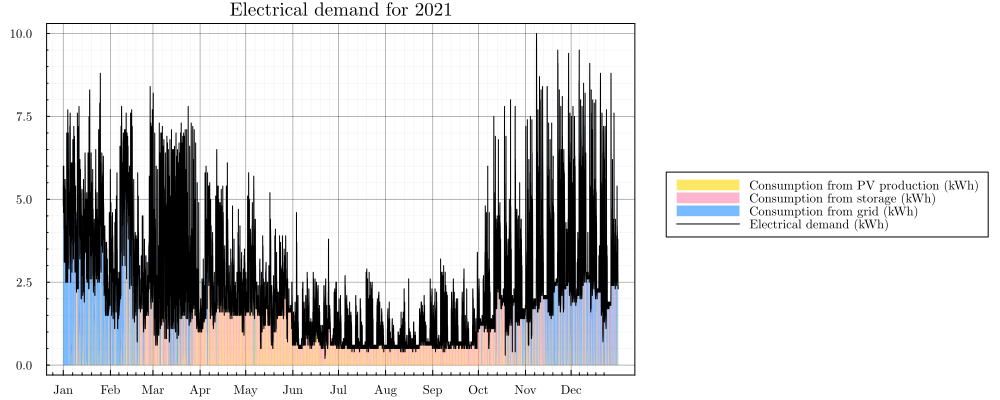

In [116]:
# Plot electrical demand
plt_elec = plot(linewidth=2, xticks=(dates_ticks,dates_month), legend=:outerright, size=(1000,400), title="Electrical demand for 2021")
line_ref = zeros(length(T))
plot!(plt_elec, dates, line_ref, label="Consumption from PV production (kWh)", fillrange=line_ref+line_PV_DE, fillalpha=0.6, linewidth=0, color=color_PV_DE)
line_ref += line_PV_DE
plot!(plt_elec, dates, line_ref, label="Consumption from storage (kWh)", fillrange=line_ref+line_SE_DE, fillalpha=0.6, linewidth=0, color=color_SE_DE)
line_ref += line_SE_DE
plot!(plt_elec, dates, line_ref, label="Consumption from grid (kWh)", fillrange=line_ref+line_PG_DE, fillalpha=0.6, linewidth=0, color=color_PG_DE)
plot!(plt_elec, dates, line_D_DE, label="Electrical demand (kWh)", linewidth=1, color=:black)

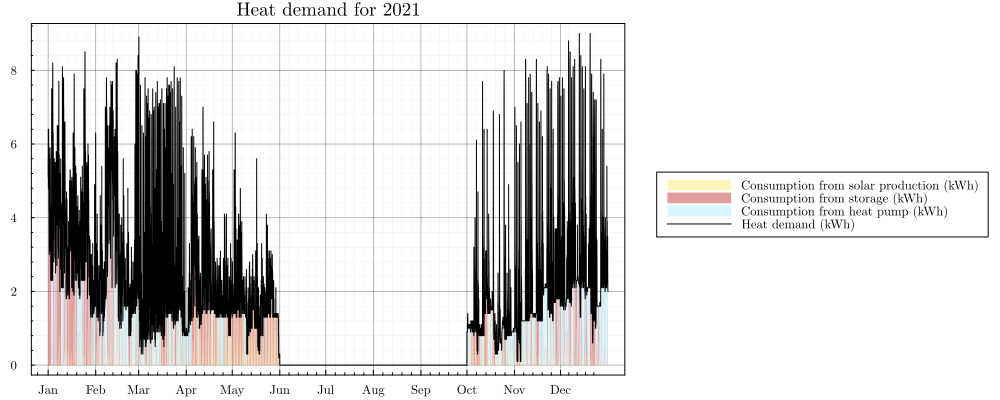

In [117]:
# Plot heat demand - longer horizon
plt_heat = plot(linewidth=2, xticks=(dates_ticks,dates_month), legend=:outerright, size=(1000,400), title="Heat demand for 2021")
line_ref = zeros(length(T))
plot!(plt_heat,dates, line_ref, label="Consumption from solar production (kWh)", fillrange=line_ref+line_ST_DH, fillalpha=0.6, linewidth=0, color=color_ST_DH)
line_ref += line_ST_DH
plot!(plt_heat,dates, line_ref, label="Consumption from storage (kWh)", fillrange=line_ref+line_SH_DH, fillalpha=0.6, linewidth=0, color=color_SH_DH)
line_ref += line_SH_DH
plot!(plt_heat,dates, line_ref, label="Consumption from heat pump (kWh)", fillrange=line_ref+line_HP_DH, fillalpha=0.6, linewidth=0, color=color_HP_DH)
plot!(plt_heat,dates, line_D_DH, label="Heat demand (kWh)", linewidth=1, color=:black)

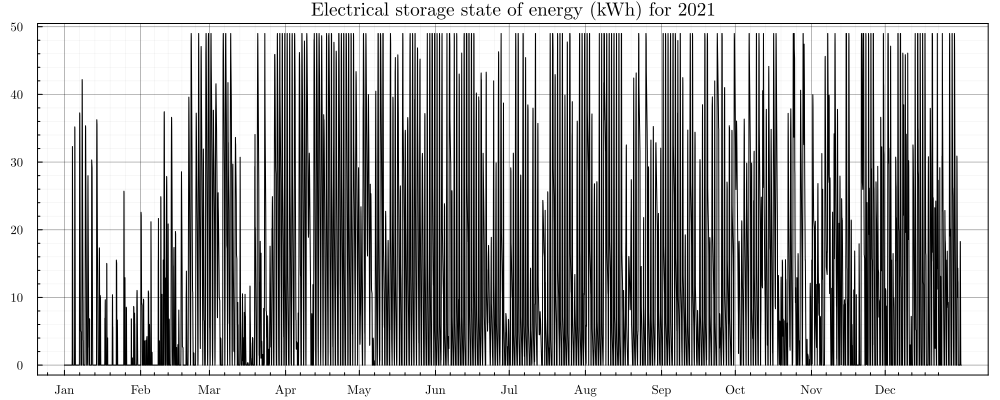

In [118]:
# Plot electrical storage soe
plt_soe = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Electrical storage state of energy (kWh) for 2021")
plot!(plt_soe,dates,Array(results["e_SE"][T]), linewidth=1, color=:black)

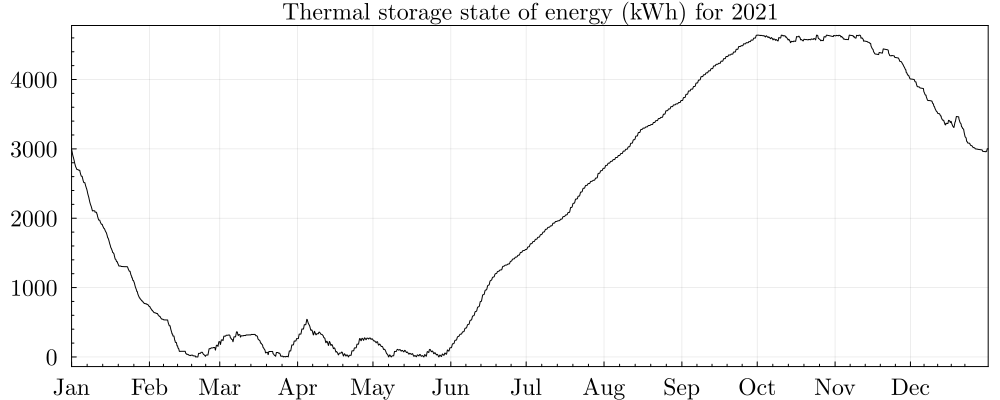

In [119]:
# Plot heat storage soe
plt_soe = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)), legend=false, size=(1000,400),
    tickfontsize=15, minorgrid=false, gridalpha=0.1, bottom_margin=2Plots.mm, title="Thermal storage state of energy (kWh) for 2021", titlefontsize=15)
plot!(plt_soe,dates,Array(results["e_SH"][T]), linewidth=1, color=:black)
display(plt_soe)
soe_SH_vec_fh = Array(results["e_SH"][T]);

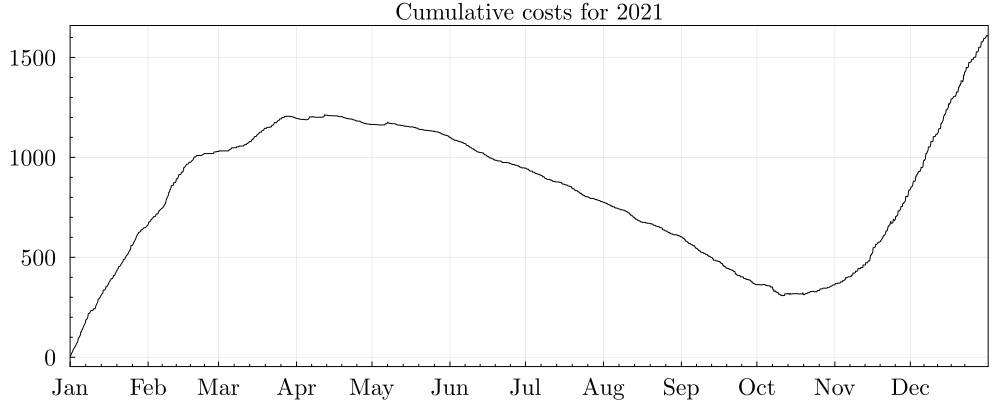

In [120]:
# Cumulative costs and plot
cumul_costs_vec_fh = []
cost_old = 0
for t in T
    global cumul_costs_vec_fh, cost_old
    cost =  Δt*(C_buy[t]*(results["p_PG_DE"][t] + results["p_PG_SE"][t] + results["p_PG_HP"][t]) - C_sell[t]*(results["p_PV_PG"][t] + results["p_SE_PG"][t])) 
    append!(cumul_costs_vec_fh, cost_old + cost)
    cost_old += cost
end
plt_cost = plot(palette=:seaborn_muted, legend=false, linewidth=2, xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    size=(1000,400), tickfontsize=15, minorgrid=false, gridalpha=0.1, bottom_margin=2Plots.mm, titlefontsize=15, title="Cumulative costs for 2021")
plot!(plt_cost, dates, cumul_costs_vec_fh, linewidth=1, color=:black)

### Plots for all the other variables

In [121]:
#=
# Plot power from stg elec to load
plt_res1 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the electrical storage to the electrical load (kW) for 2021")
plot!(plt_res1,dates,Array(results["p_SE_DE"][T]), linewidth=1, color=:black)
=#

In [122]:
#=
# Plot power from stg heat to load
plt_res2 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the thermal storage to the thermal load (kW) for 2021")
plot!(plt_res2,dates,Array(results["p_SH_DH"][T]), linewidth=1, color=:black)
=#

In [123]:
#=
# Plot power from stg elec to grid
plt_res3 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the electrical storage to the grid (kW) for 2021")
plot!(plt_res3,dates,Array(results["p_SE_PG"][T]), linewidth=1, color=:black)
=#

In [124]:
#=
# Plot power from stg elec to HP
plt_res4 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the electrical storage to the heat pump (kW) for 2021")
plot!(plt_res4,dates,Array(results["p_SE_HP"][T]), linewidth=1, color=:black)
=#

In [125]:
#=
# Plot power from grid to stg elec
plt_res5 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the grid to the electrical storage (kW) for 2021")
plot!(plt_res5,dates,Array(results["p_PG_SE"][T]), linewidth=1, color=:black)
=#

In [126]:
#=
# Plot power from grid to load elec
plt_res6 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the grid to the electrical load (kW) for 2021")
plot!(plt_res6,dates,Array(results["p_PG_DE"][T]), linewidth=1, color=:black)
=#

In [127]:
#=
# Plot power from grid to heat pump
plt_res7 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the grid to the heat pump (kW) for 2021")
plot!(plt_res7,dates,Array(results["p_PG_HP"][T]), linewidth=1, color=:black)
=#

In [128]:
#=
# Plot power from heat pump to stg heat
plt_res8 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the heat pump to the thermal storage (kW) for 2021")
plot!(plt_res8,dates,Array(results["p_HP_SH"][T]), linewidth=1, color=:black)
=#

In [129]:
#=
# Plot power from heat pump to load heat
plt_res9 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the heat pump to the thermal load (kW) for 2021")
plot!(plt_res9,dates,Array(results["p_HP_DH"][T]), linewidth=1, color=:black)
=#

In [130]:
#=
# Plot power from PV to stg elec
plt_res10 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar PV to the electrical storage (kW) for 2021")
plot!(plt_res10,dates,Array(results["p_PV_SE"][T]), linewidth=1, color=:black)
=#

In [131]:
#=
# Plot power from PV to load elec
plt_res11 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar PV to the electrical load (kW) for 2021")
plot!(plt_res11,dates,Array(results["p_PV_DE"][T]), linewidth=1, color=:black)
=#

In [132]:
#=
# Plot power from PV to grid
plt_res12 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar PV to the grid (kW) for 2021")
plot!(plt_res12,dates,Array(results["p_PV_PG"][T]), linewidth=1, color=:black)
=#

In [133]:
#=
# Plot power from PV to HP
plt_res13 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar PV to the heat pump (kW) for 2021")
plot!(plt_res13,dates,Array(results["p_PV_HP"][T]), linewidth=1, color=:black)
=#

In [134]:
#=
# Plot power from solar to stg heat
plt_res14 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar thermal to the thermal storage (kW) for 2021")
plot!(plt_res14, dates,Array(results["p_ST_SH"][T]), linewidth=1, color=:black)
=#

In [135]:
#=
# Plot power from solar to load heat
plt_res15 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from the solar thermal to the thermal load (kW) for 2021")
plot!(plt_res15, dates,Array(results["p_ST_DH"][T]), linewidth=1, color=:black)
=#

In [136]:
#=
# Plot power from solar to stg heat
plt_res16 = plot(xticks=(dates_ticks,dates_month), legend=false, size=(1000,400), title="Power from AC to the thermal storage (kW) for 2021")
plot!(plt_res16, dates,Array(results["p_AC_SH"][T]), linewidth=1, color=:black)
=#

## Length of the horizon

### Determine Optimal Horizon

In [137]:
#=
# Determine min horizon
E_SH_init_loc = E_SH_init 
E_SE_init_loc = E_SE_init 
nb_d_min = []
cumul_cost_vec = []
soe_SE_vec = []
soe_SH_vec = []
cumul_cost = 0
max_length = 300
data_avail = length(D_DH[:,"load"])
nb_d_h_min = 1

for d in 1:nb_d
    diff_level = 100
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    E_SH_min = E_SH_init_loc
    for t in start_d:24*(d+nb_d_h_min-2)
        E_SH_min = ceil(max(0, ρ_SH * E_SH_min - Δt * (1/η_SH_dis) * min(D_DH[t,"load"],P_SH_dis)),digits=3)
    end
    E_SH_max = E_SH_init_loc
    for t in start_d:24*(d+nb_d_h_min-2) # Start from previous level
        if D_DH[t,"load"] - P_ST[t,"prod"] <= P_HP
            charge_max = min(P_SH_ch, P_HP + P_ST[t,"prod"] + P_AC[t,"prod"] - D_DH[t,"load"])
            E_SH_max = min(E_SH_ub, ρ_SH * E_SH_max + Δt * η_SH_ch * charge_max)
        else
            discharge_min = min(P_SH_dis, D_DH[t,"load"] - P_ST[t,"prod"] - P_HP)
            E_SH_max = floor(max(0, ρ_SH * E_SH_max - Δt * (1/η_SH_dis) * discharge_min),digits=3)
        end
    end
    nb_d_h = nb_d_h_min

    while diff_level > 1e-6 && nb_d_h < max_length && 24*(d+nb_d_h-1)<=data_avail
        global results_high, T_run
        end_run = 24*(d+nb_d_h-1)
        T_run = [start_d:end_run;]
        H = length(T_run)
        # Calculate lowest reachable level
        E_SE_min = ceil(max(E_SE_lb, (ρ_SE ^ H) * E_SE_init_loc - sum(ρ_SE ^ (t-1) for t = 1:H) * Δt * (1/η_SE_dis) * P_SE_dis),digits=3)
        for t in end_run-23:end_run # Start from previous level
            E_SH_min = ceil(max(E_SH_lb, ρ_SH * E_SH_min - Δt * (1/η_SH_dis) * min(D_DH[t,"load"],P_SH_dis)),digits=3)
        end
        # Optimization for lowest reachable level
        results_low = syst_schedule([1:end_run-start_d+1;], E_SE_min, E_SH_min, C_buy[T_run], C_sell[T_run], E_SE_init_loc, E_SH_init_loc, start_d)
        E_final_elec_min = results_low["e_SE"][24]
        E_final_heat_min = results_low["e_SH"][24]

        # Calculate highest reachable level
        E_SE_max = floor(min(E_SE_ub, (ρ_SE ^ H) * E_SE_init_loc + sum(ρ_SE ^ (t-1) for t = 1:H) * Δt * η_SE_ch * P_SE_ch),digits=3)
        for t in end_run-23:end_run # Start from previous level
            if D_DH[t,"load"] - P_ST[t,"prod"] <= P_HP
                charge_max = min(P_SH_ch, P_HP + P_ST[t,"prod"] + P_AC[t,"prod"] - D_DH[t,"load"])
                E_SH_max = min(E_SH_ub, ρ_SH * E_SH_max + Δt * η_SH_ch * charge_max)
            else
                discharge_min = min(P_SH_dis, D_DH[t,"load"] - P_ST[t,"prod"] - P_HP)
                E_SH_max = floor(max(E_SH_lb, ρ_SH * E_SH_max - Δt * (1/η_SH_dis) * discharge_min),digits=3)
            end
        end
        # Optimization for highest reachable level
        results_high = syst_schedule([1:end_run-start_d+1;], E_SE_max, E_SH_max, C_buy[T_run], C_sell[T_run], E_SE_init_loc, E_SH_init_loc, start_d)
        E_final_elec_max = results_high["e_SE"][24]
        E_final_heat_max = results_high["e_SH"][24]

        diff_level = max(E_final_elec_max-E_final_elec_min,E_final_heat_max-E_final_heat_min)
        nb_d_h += 1
    end
    nb_d_h -= 1
    println("Day ",d,": ",nb_d_h)
    append!(nb_d_min, nb_d_h)
    E_SH_init_loc = results_high["e_SH"][24]
    E_SE_init_loc = results_high["e_SE"][24]
    for t in 1:24
        cumul_cost += Δt*(C_buy[T_run][t]*(results_high["p_PG_DE"][t] + results_high["p_PG_SE"][t] + results_high["p_PG_HP"][t])-C_sell[T_run][t]*(results_high["p_PV_PG"][t] + results_high["p_SE_PG"][t]))
        append!(cumul_cost_vec, cumul_cost)
        append!(soe_SE_vec, results_high["e_SE"][t, 1])
        append!(soe_SH_vec, results_high["e_SH"][t, 1])
    end
end
writedlm("nb_d_min.csv", nb_d_min, ", ")

println("Costs for an optimized rolling-horizon window: ",round(cumul_cost, digits=2))
=#

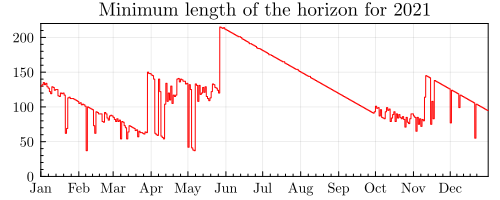

In [138]:
nb_d_df = CSV.read("nb_d_min.csv", DataFrame)
nb_d_min = (nb_d_df.Horizon)
nb_d_min_24 = []
for d in 1:nb_d
    for t in 1:24
        append!(nb_d_min_24, nb_d_min[d])
    end
end
# Plot minimum horizon
plt_h = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)), ylims=(0,220), size=(500,200),
    legend=false, guidefontsize=11, tickfontsize=9, minorgrid=false, gridalpha=0.1, title="Minimum length of the horizon for 2021")
plot!(plt_h, dates, nb_d_min_24, linewidth=1, color=:red)

### Results for optimal horizon

In [139]:

# Costs for an optimal window
nb_d_df = CSV.read("nb_d_min.csv", DataFrame)
nb_d_min = (nb_d_df.Horizon)
E_SH_init_loc_nd = E_SH_init 
E_SE_init_loc_nd = E_SE_init 
cumul_cost_vec = []
soe_SE_vec = []
soe_SH_vec = []
cumul_cost_nd = 0

for d in 1:nb_d
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    end_run = 24*(d+nb_d_min[d]-1)
    T_run = [start_d:end_run;]
    H = length(T_run)
 
    # Optimization for lowest reachable level
    results_nd = syst_schedule([1:end_run-start_d+1;], "free", "free", C_buy[T_run], C_sell[T_run], E_SE_init_loc_nd, E_SH_init_loc_nd, start_d)

    E_SH_init_loc_nd = results_nd["e_SH"][24]
    E_SE_init_loc_nd = results_nd["e_SE"][24]
    for t in 1:24
        cumul_cost_nd += Δt*(C_buy[T_run][t]*(results_nd["p_PG_DE"][t] + results_nd["p_PG_SE"][t] + results_nd["p_PG_HP"][t])-C_sell[T_run][t]*(results_nd["p_PV_PG"][t] + results_nd["p_SE_PG"][t]))
        append!(cumul_cost_vec, cumul_cost_nd)
        append!(soe_SE_vec, results_nd["e_SE"][t, 1])
        append!(soe_SH_vec, results_nd["e_SH"][t, 1])
    end
end
println("Costs for a rolling-horizon with optimal window : ", round(cumul_cost_nd, digits=2))


Costs for a rolling-horizon with optimal window : 1631.9


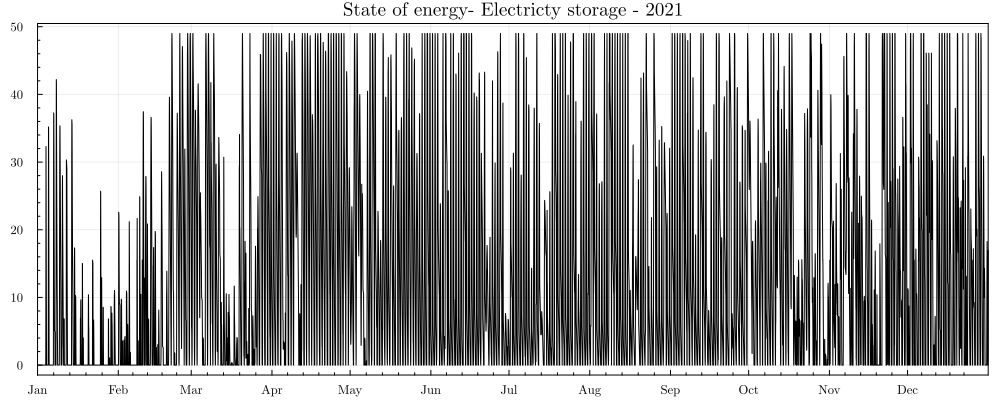

In [140]:

# Plot state of energy - Elec
plt_soe_SE_2 = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="State of energy- Electricty storage - 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_soe_SE_2, dates, soe_SE_vec, linewidth=1, color=:black)


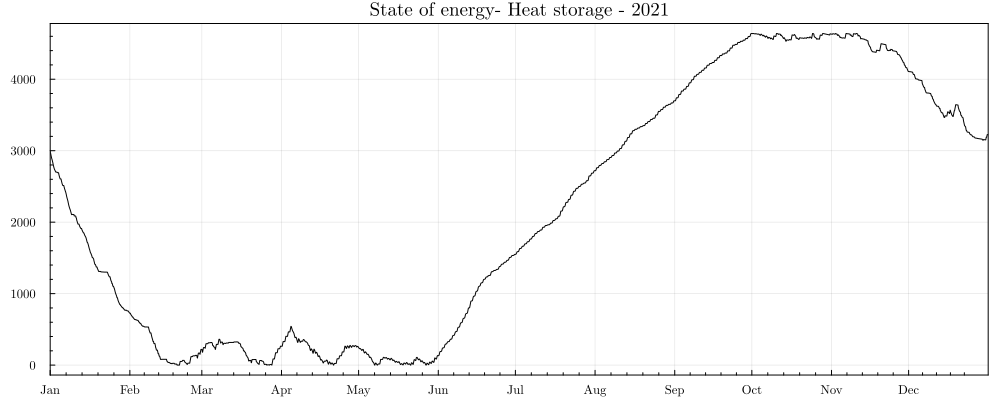

In [141]:

# Plot state of energy - Heat
plt_soe_SH_2 = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="State of energy- Heat storage - 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_soe_SH_2, dates, soe_SH_vec, linewidth=1, color=:black)


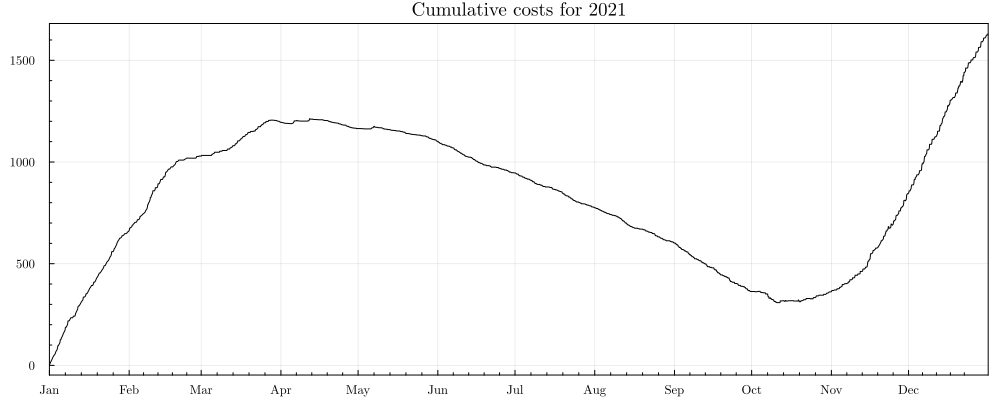

In [142]:
#
# Plot cumulative costs
plt_cost_2 = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="Cumulative costs for 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_cost_2, dates, cumul_cost_vec, linewidth=1, color=:black)


## Optimal levels for 2020

In [143]:
#=
# Parameters for 2020

# Prices
C_df = CSV.read("Day-ahead Prices_DK2_2020.csv", DataFrame)
C_array = 0.001*(C_df.Price) # Multiply by 0.001 for unit conversion
C_buy = C_array.+0.2
C_sell = C_array

# Electrical load
D_DE = CSV.read("data_D_DE_2020.csv", DataFrame)

# Heat load
D_DH = CSV.read("data_D_DH_2020.csv", DataFrame)
D_DH = (-1) .* D_DH[:,2:end]

# Heat from AC
P_AC = CSV.read("data_P_AC_2020.csv", DataFrame)
P_AC = (-1) .* P_AC[:,2:end]

# Solar prod
nb_solar = 9
eff_solar = 0.9
P_ST = CSV.read("data_P_ST_2020.csv", DataFrame) # Irradiance data
P_ST = coalesce.(P_ST, 0) # Replace missing entries with 0 (no production)
P_ST = (0.001 * eff_solar * nb_solar) .* P_ST[:,2:end] # Multiply by 0.001 for unit conversion

# PV prod
nb_PV = 80
P_PV = CSV.read("data_P_PV_2020.csv", DataFrame) # Production of 1 PV
P_PV = coalesce.(P_PV, 0) # Replace missing entries with 0 (no production)
P_PV = (0.001 * nb_PV) .* P_PV[:,2:end] # Multiply by 0.001 for unit conversion
;
=#

In [144]:
#=
bin_ch_dch = "neg"
start_d=1
results_2020 = syst_schedule(T, E_SE_end, E_SH_end, C_buy, C_sell, E_SE_init, E_SH_init, start_d)
;
=#

In [145]:
#=
# Check simultaneous charge and discharge
for t in T
    if (results_2020["p_PV_SE"][t] + results_2020["p_PG_SE"][t]) >= 1e-6 && (results_2020["p_SE_DE"][t] + results_2020["p_SE_PG"][t] + results_2020["p_SE_HP"][t]) >= 1e-6
        println("Simultaneous charge and discharge for elec storage at t=", t, ",for the price ",C_sell[t])
    elseif (results_2020["p_AC_SH"][t] + results_2020["p_HP_SH"][t] + results_2020["p_ST_SH"][t]) >= 1e-6 && results_2020["p_SH_DH"][t] >= 1e-6
        println("Simultaneous charge and discharge for heat storage at t=", t, ",for the price ",C_sell[t])
    end
end
=#

In [146]:
#=
# Get final daily levels for 2020
final_heat_d = []
for d in 1:nb_d
    append!(final_heat_d, results_2020["e_SH"][24*d])
end
writedlm("final_heat_d_2020.csv", final_heat_d, ", ")

final_elec_d = []
for d in 1:nb_d
    append!(final_elec_d, results_2020["e_SE"][24*d])
end
writedlm("final_elec_d_2020.csv", final_elec_d, ", ")
=#

In [147]:
#=
# Plot heat storage soe for 2020
plt_soe = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)), 
    legend=false, size=(1000,400), title="Thermal storage state of energy (kWh) for 2020", minorgrid=false, gridalpha=0.1)
plot!(plt_soe,dates,Array(results_2020["e_SH"][T]), linewidth=1, color=:black)
=#

## Run hybrid approach

In [148]:
#=
# Parameters for 2021

# Prices
C_df = CSV.read("Day-ahead Prices_DK2_2021_2022.csv", DataFrame)
C_array = 0.001*(C_df.Price) # Multiply by 0.001 for unit conversion
C_buy = C_array.+0.2
C_sell = C_array

# Electrical load
D_DE = CSV.read("data_D_DE.csv", DataFrame)

# Heat load
D_DH = CSV.read("data_D_DH.csv", DataFrame)
D_DH = (-1) .* D_DH[:,2:end]

# Heat from AC
P_AC = CSV.read("data_P_AC.csv", DataFrame)
P_AC = (-1) .* P_AC[:,2:end]

# Solar prod
nb_solar = 9
eff_solar = 0.9
P_ST = CSV.read("data_P_ST.csv", DataFrame) # Irradiance data
P_ST = coalesce.(P_ST, 0) # Replace missing entries with 0 (no production)
P_ST = (0.001 * eff_solar * nb_solar) .* P_ST[:,2:end] # Multiply by 0.001 for unit conversion

# PV prod
nb_PV = 80
P_PV = CSV.read("data_P_PV.csv", DataFrame) # Production of 1 PV
P_PV = coalesce.(P_PV, 0) # Replace missing entries with 0 (no production)
P_PV = (0.001 * nb_PV) .* P_PV[:,2:end] # Multiply by 0.001 for unit conversion
;
=#

In [149]:
# Final levels
final_heat_d_df = CSV.read("final_heat_d_2020.csv", DataFrame)
final_heat_d = (final_heat_d_df.Level)
;

In [150]:

bin_ch_dch = "neg"
nb_d_h = 30
E_SH_init_loc_hyb = E_SH_init 
E_SE_init_loc_hyb = E_SE_init
cumul_cost_vec_hyb = []
soe_SH_vec_hyb = []
cumul_cost_hyb = 0

for d in 1:nb_d
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    end_run = min(24*(d+nb_d_h-1),24*nb_d)
    T_run = [start_d:end_run;]
    H = length(T_run)
 
    # Optimization for lowest reachable level
    results_hyb  = syst_schedule([1:end_run-start_d+1;], E_SE_end, final_heat_d[min(d+nb_d_h-1,nb_d)], C_buy[T_run], C_sell[T_run], E_SE_init_loc_hyb, E_SH_init_loc_hyb, start_d)

    E_SH_init_loc_hyb  = results_hyb["e_SH"][24]
    E_SE_init_loc_hyb  = results_hyb["e_SE"][24]
    for t in 1:24
        cumul_cost_hyb += Δt*(C_buy[T_run][t]*(results_hyb["p_PG_DE"][t] + results_hyb["p_PG_SE"][t] + results_hyb["p_PG_HP"][t])-C_sell[T_run][t]*(results_hyb["p_PV_PG"][t] + results_hyb["p_SE_PG"][t]))
        append!(cumul_cost_vec_hyb, cumul_cost_hyb)
        append!(soe_SH_vec_hyb, results_hyb["e_SH"][t, 1])
    end
end
println("Costs for a rolling-horizon window of ", nb_d_h ," days: ",round(cumul_cost_hyb, digits=2))
;


Costs for a rolling-horizon window of 30 days: 1625.04


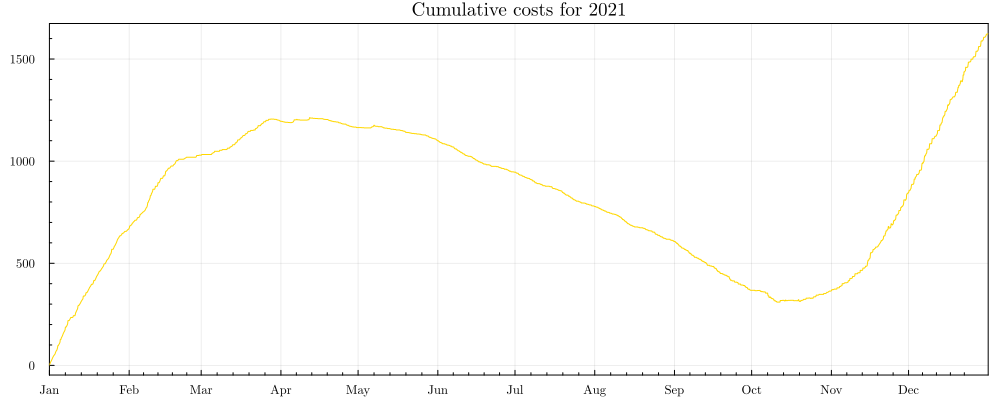

In [151]:

# Plot cumulative costs - fixed final level
plt_cost = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="Cumulative costs for 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_cost, dates, cumul_cost_vec_hyb, linewidth=1, color=:gold)

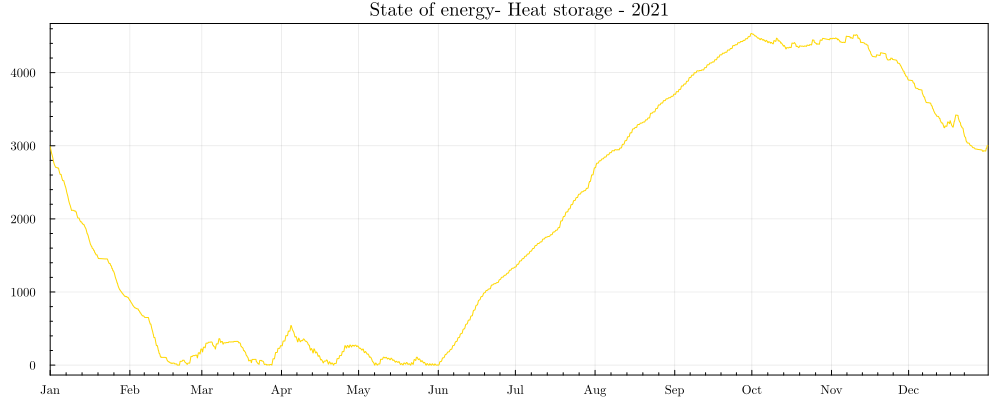

In [152]:

# Plot state of energy - fixed final level
plt_soe_SH = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="State of energy- Heat storage - 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_soe_SH,dates,soe_SH_vec_hyb, label="Final level from 2020", linewidth=1, color=:gold)


### Hybrid 42 days for plot

In [153]:

bin_ch_dch = "neg"
nb_d_h = 42
E_SH_init_loc_hyb = E_SH_init 
E_SE_init_loc_hyb = E_SE_init
cumul_cost_vec_hyb = []
soe_SH_vec_hyb = []
cumul_cost_hyb = 0

for d in 1:nb_d
    #println(d)
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    end_run = min(24*(d+nb_d_h-1),24*nb_d)
    T_run = [start_d:end_run;]
    H = length(T_run)
 
    # Optimization for lowest reachable level
    results_hyb  = syst_schedule([1:end_run-start_d+1;], E_SE_end, final_heat_d[min(d+nb_d_h-1,nb_d)], C_buy[T_run], C_sell[T_run], E_SE_init_loc_hyb, E_SH_init_loc_hyb, start_d)

    E_SH_init_loc_hyb  = results_hyb["e_SH"][24]
    E_SE_init_loc_hyb  = results_hyb["e_SE"][24]
    for t in 1:24
        cumul_cost_hyb += Δt*(C_buy[T_run][t]*(results_hyb["p_PG_DE"][t] + results_hyb["p_PG_SE"][t] + results_hyb["p_PG_HP"][t])-C_sell[T_run][t]*(results_hyb["p_PV_PG"][t] + results_hyb["p_SE_PG"][t]))
        append!(cumul_cost_vec_hyb, cumul_cost_hyb)
        append!(soe_SH_vec_hyb, results_hyb["e_SH"][t, 1])
    end
end
println("Costs for a rolling-horizon window of ", nb_d_h ," days: ",round(cumul_cost_hyb, digits=2))

cumul_cost_vec_hyb_42 = cumul_cost_vec_hyb
soe_SH_vec_hyb_42 = soe_SH_vec_hyb
;


Costs for a rolling-horizon window of 42 days: 1617.58


### Hybrid 6 days for plot

In [154]:

bin_ch_dch = "neg"

nb_d_h = 6
E_SH_init_loc_hyb = E_SH_init 
E_SE_init_loc_hyb = E_SE_init
cumul_cost_vec_hyb = []
soe_SH_vec_hyb = []
cumul_cost_hyb = 0

for d in 1:nb_d
    #println(d)
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    end_run = min(24*(d+nb_d_h-1),24*nb_d)
    T_run = [start_d:end_run;]
    H = length(T_run)
 
    # Optimization for lowest reachable level
    results_hyb  = syst_schedule([1:end_run-start_d+1;], E_SE_end, final_heat_d[min(d+nb_d_h-1,nb_d)], C_buy[T_run], C_sell[T_run], E_SE_init_loc_hyb, E_SH_init_loc_hyb, start_d)

    E_SH_init_loc_hyb  = results_hyb["e_SH"][24]
    E_SE_init_loc_hyb  = results_hyb["e_SE"][24]
    for t in 1:24
        cumul_cost_hyb += Δt*(C_buy[T_run][t]*(results_hyb["p_PG_DE"][t] + results_hyb["p_PG_SE"][t] + results_hyb["p_PG_HP"][t])-C_sell[T_run][t]*(results_hyb["p_PV_PG"][t] + results_hyb["p_SE_PG"][t]))
        append!(cumul_cost_vec_hyb, cumul_cost_hyb)
        append!(soe_SH_vec_hyb, results_hyb["e_SH"][t, 1])
    end
end
println("Costs for a rolling-horizon window of ", nb_d_h ," days: ",round(cumul_cost_hyb, digits=2))

cumul_cost_vec_hyb_6 = cumul_cost_vec_hyb
soe_SH_vec_hyb_6 = soe_SH_vec_hyb

;


Costs for a rolling-horizon window of 6 days: 1664.6


## Fixed final level - 42 days

In [155]:
#=
# Parameters for 2021

# Prices
C_df = CSV.read("Day-ahead Prices_DK2_2021_2022.csv", DataFrame)
C_array = 0.001*(C_df.Price) # Multiply by 0.001 for unit conversion
C_buy = C_array.+0.2
C_sell = C_array

# Electrical load
D_DE = CSV.read("data_D_DE.csv", DataFrame)

# Heat load
D_DH = CSV.read("data_D_DH.csv", DataFrame)
D_DH = (-1) .* D_DH[:,2:end]

# Heat from AC
P_AC = CSV.read("data_P_AC.csv", DataFrame)
P_AC = (-1) .* P_AC[:,2:end]

# Solar prod
nb_solar = 9
eff_solar = 0.9
P_ST = CSV.read("data_P_ST.csv", DataFrame) # Irradiance data
P_ST = coalesce.(P_ST, 0) # Replace missing entries with 0 (no production)
P_ST = (0.001 * eff_solar * nb_solar) .* P_ST[:,2:end] # Multiply by 0.001 for unit conversion

# PV prod
nb_PV = 80
P_PV = CSV.read("data_P_PV.csv", DataFrame) # Production of 1 PV
P_PV = coalesce.(P_PV, 0) # Replace missing entries with 0 (no production)
P_PV = (0.001 * nb_PV) .* P_PV[:,2:end] # Multiply by 0.001 for unit conversion
;
=#

In [156]:

bin_ch_dch = "neg"
nb_d_h = 42
E_SH_init_loc_fix = E_SH_init 
E_SE_init_loc_fix = E_SE_init
cumul_cost_vec_fix = []
soe_SH_vec_fix = []
cumul_cost_fix = 0

for d in 1:nb_d
    start_d = 1+24*(d-1)
    end_d = start_d + 23
    end_run = min(24*(d+nb_d_h-1),24*nb_d)
    T_run = [start_d:end_run;]
    H = length(T_run)
 
    # Optimization for lowest reachable level
    results_fix  = syst_schedule([1:end_run-start_d+1;], E_SE_end, E_SH_end, C_buy[T_run], C_sell[T_run], E_SE_init_loc_fix, E_SH_init_loc_fix, start_d)

    E_SH_init_loc_fix  = results_fix["e_SH"][24]
    E_SE_init_loc_fix  = results_fix["e_SE"][24]
    for t in 1:24
        cumul_cost_fix += Δt*(C_buy[T_run][t]*(results_fix["p_PG_DE"][t] + results_fix["p_PG_SE"][t] + results_fix["p_PG_HP"][t])-C_sell[T_run][t]*(results_fix["p_PV_PG"][t] + results_fix["p_SE_PG"][t]))
        append!(cumul_cost_vec_fix, cumul_cost_fix)
        append!(soe_SH_vec_fix, results_fix["e_SH"][t, 1])
    end
end
println("Costs for a rolling-horizon window of 42 days: ",round(cumul_cost_fix, digits=2))
;


Costs for a rolling-horizon window of 42 days: 1774.02


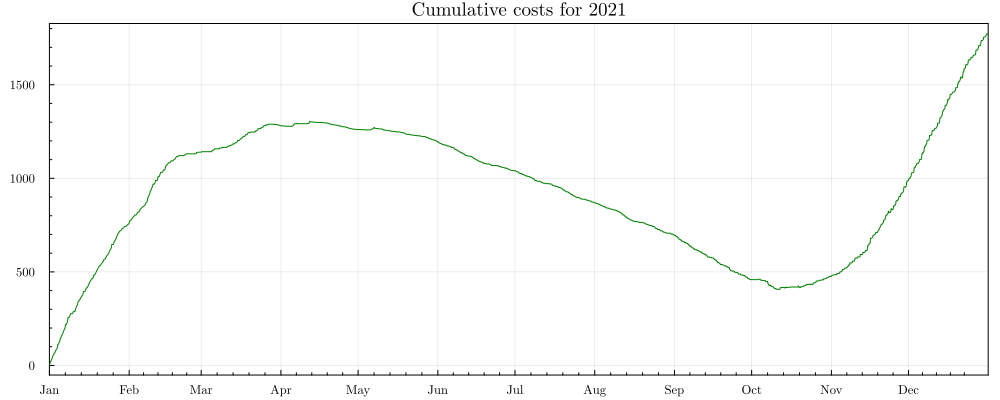

In [157]:

# Plot cumulative costs - fixed final level
plt_cost = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="Cumulative costs for 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_cost, dates, cumul_cost_vec_fix, linewidth=1, color=:green)



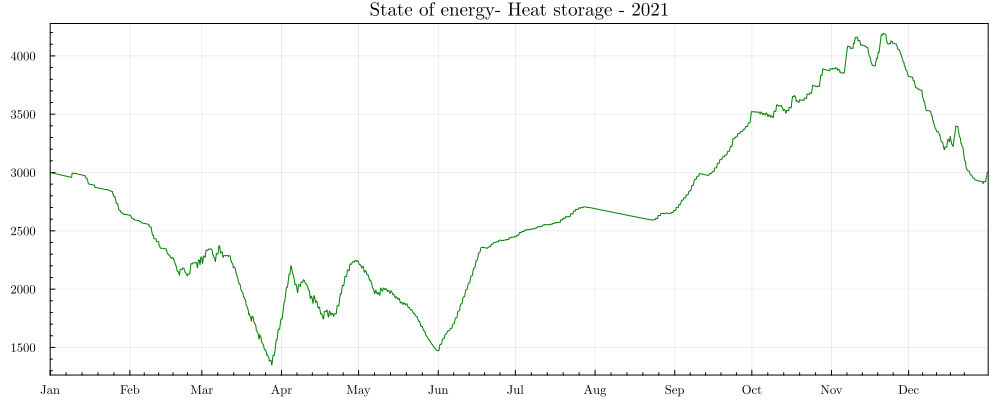

In [158]:

# Plot state of energy - fixed final level
plt_soe_SH = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)),
    legend=false, size=(1000,400), title="State of energy- Heat storage - 2021", minorgrid=false, gridalpha=0.1)
plot!(plt_soe_SH,dates,soe_SH_vec_fix, linewidth=1, color=:green)


### All results

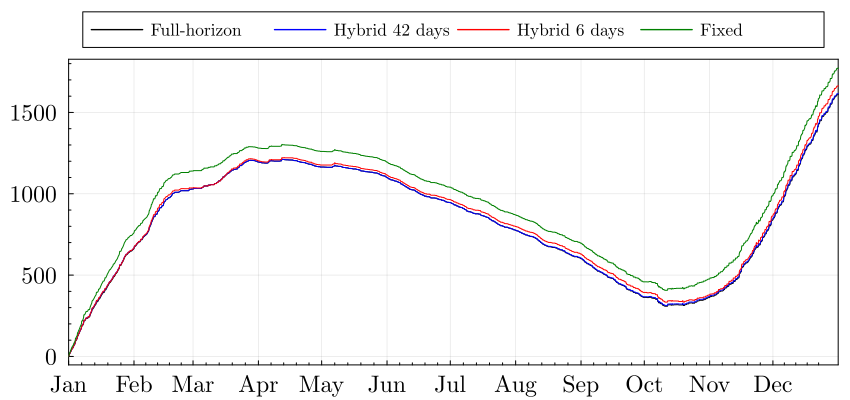

In [159]:
# Plot cumulative costs -  All results

plt_cost = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)), legend=:outertop, legendcolumns=4, legendfontsize=11, size=(850,400), tickfontsize=15, minorgrid=false, gridalpha=0.1, bottom_margin=2Plots.mm)#, title="Cumulative costs for 2021")
plot!(plt_cost, dates, cumul_costs_vec_fh, label="Full-horizon", linewidth=1, color=:black)
plot!(plt_cost, dates, cumul_cost_vec_hyb_42, label="Hybrid 42 days", linewidth=1, color=:blue)
plot!(plt_cost, dates, cumul_cost_vec_hyb_6, label="Hybrid 6 days", linewidth=1, color=:red)
plot!(plt_cost, dates, cumul_cost_vec_fix, label="Fixed", linewidth=1, color=:green)


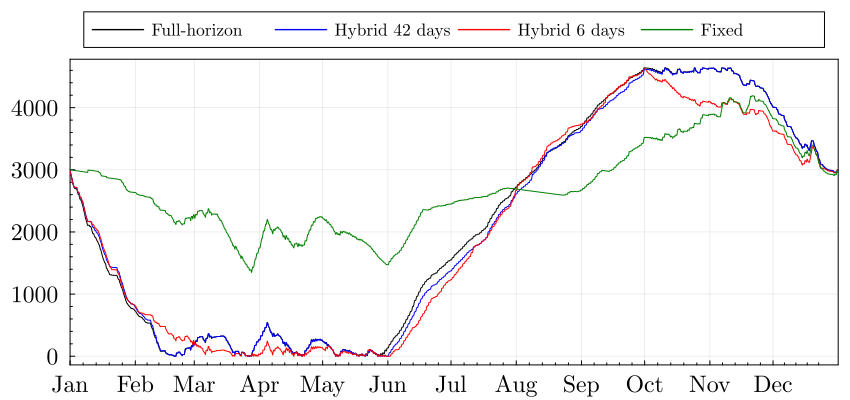

In [160]:
# Plot state of energy - All results

plt_soe_SH = plot(xticks=(dates_ticks,dates_month), xlims=(DateTime(2021,1,1,0),DateTime(2021,12,31,23)), legend=:outertop, legendcolumns=4, legendfontsize=11, size=(850,400), tickfontsize=15, minorgrid=false, gridalpha=0.1, bottom_margin=2Plots.mm)#, title="State of energy- Heat storage - 2021")
plot!(plt_soe_SH, dates, soe_SH_vec_fh, label="Full-horizon", linewidth=1, color=:black)
plot!(plt_soe_SH, dates, soe_SH_vec_hyb_42, label="Hybrid 42 days", linewidth=1, color=:blue)
plot!(plt_soe_SH, dates, soe_SH_vec_hyb_6, label="Hybrid 6 days", linewidth=1, color=:red)
plot!(plt_soe_SH, dates, soe_SH_vec_fix, label="Fixed", linewidth=1, color=:green)
